In [1]:
# Set 'Liberation Sans' as the default font
from matplotlib import rcParams
rcParams['font.family'] = 'Liberation Sans'

1. LOADING AND SUBSETTING DATA
Loaded adata: 17357 cells x 32285 genes

Sample distribution in 'sample':
sample
D3_1    9728
D0_1    7629
Name: count, dtype: int64

2. QUALITY CONTROL

QC metrics added to adata.obs:
['n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb']


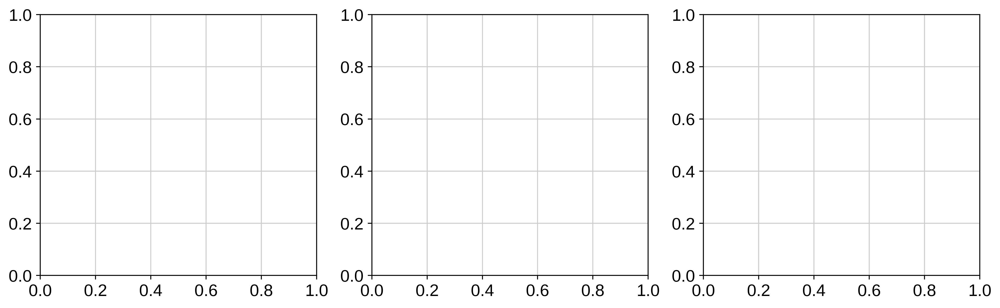

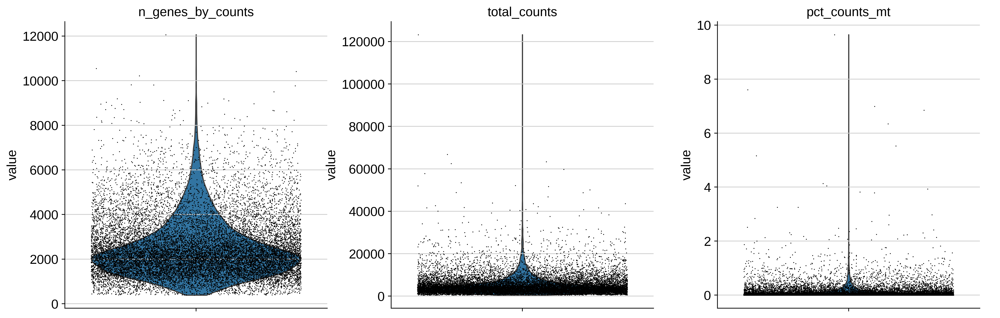

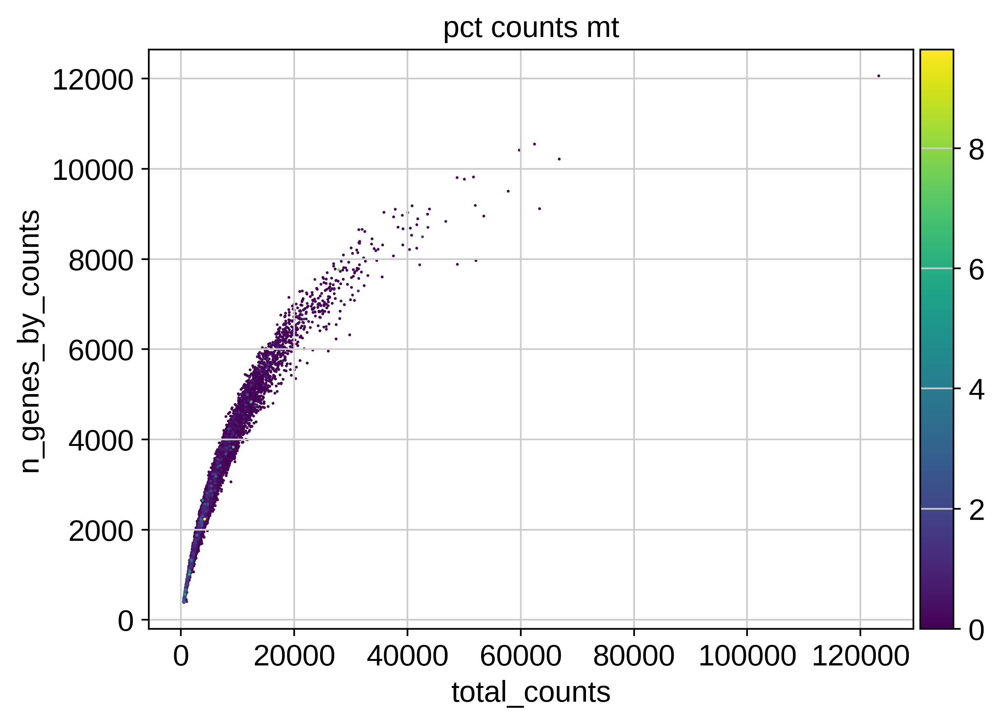

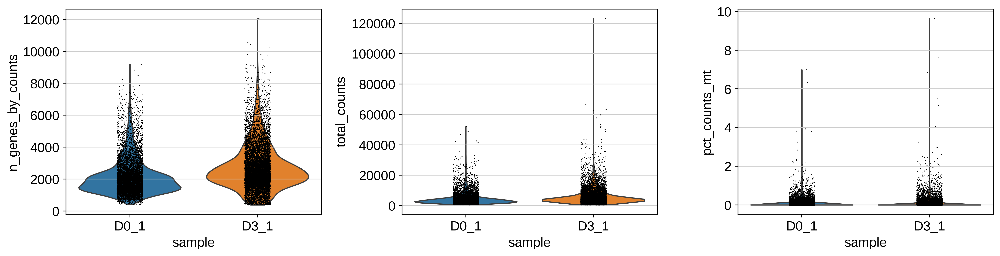

QC plots saved.

3. BASIC FILTERING
filtered out 8164 genes that are detected in less than 3 cells
Cells: 17357 -> 17357 (0 removed)
Genes: 32285 -> 24121 (8164 removed)

4. DOUBLET DETECTION
Running Scrublet
filtered out 3260 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Automatically set threshold at doublet score = 0.07
Detected doublet rate = 22.9%
Estimated detectable doublet fraction = 84.4%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 27.1%
filtered out 723 genes that are detected in less than 3 cells
normal

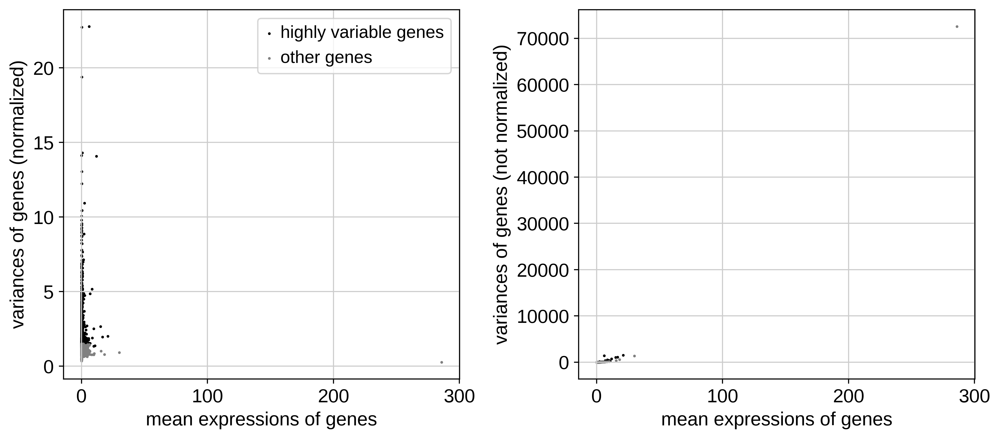


7. DIMENSIONALITY REDUCTION (PCA)
computing PCA
    with n_comps=50
    finished (0:00:02)
PCA complete: (17357, 50)


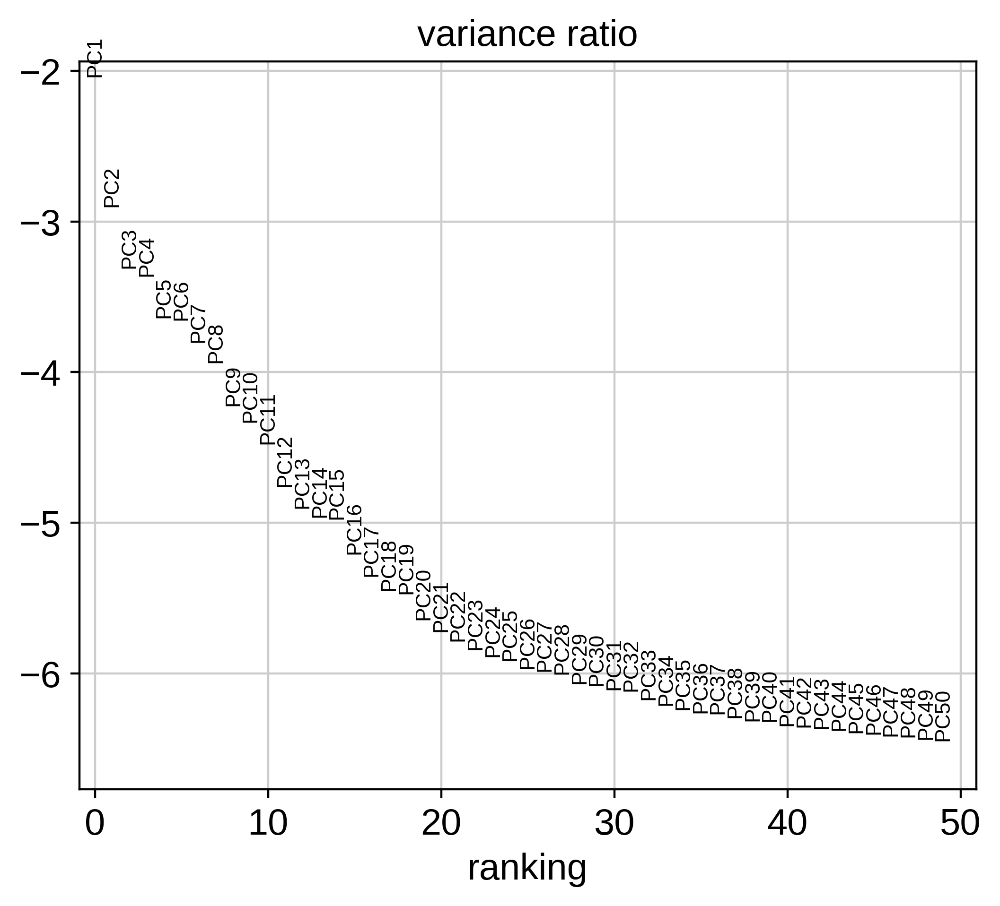

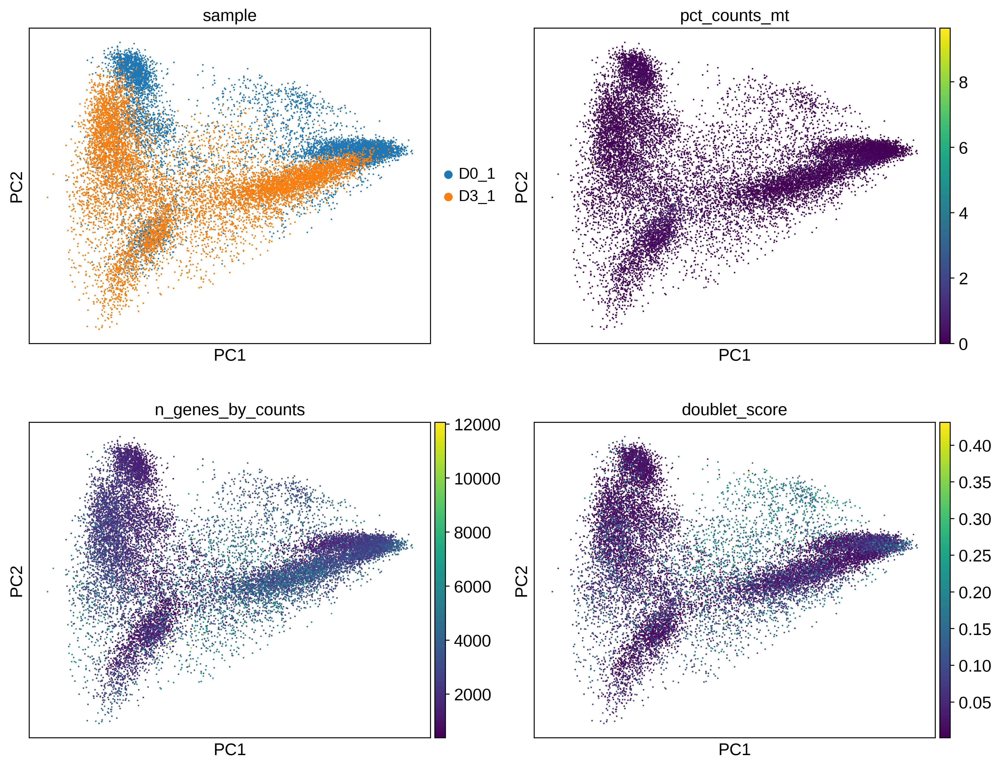


8. NEIGHBOR GRAPH AND UMAP
computing neighbors
    using 'X_pca' with n_pcs = 30


2025-12-12 17:01:48.218377: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-12-12 17:01:48.265386: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-12-12 17:01:49.391936: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:27)
UMAP complete.


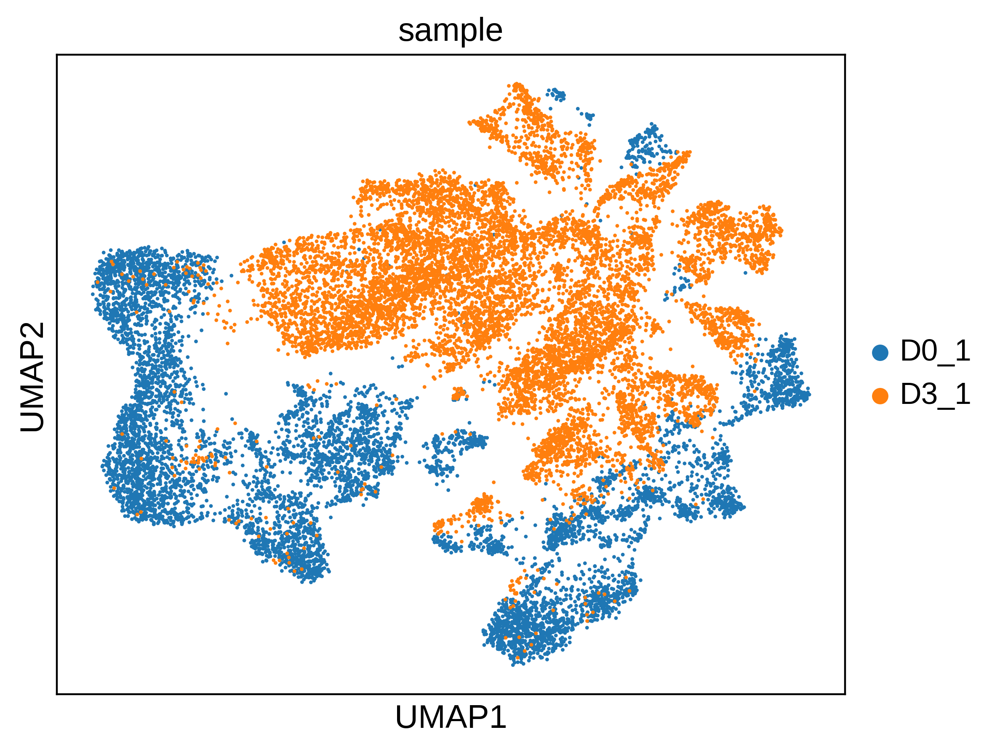


9. CLUSTERING (LEIDEN) - Resolution 1.0
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_res_0.1', the cluster labels (adata.obs, categorical) (0:00:00)
Resolution 0.1: 8 clusters
running Leiden clustering
    finished: found 14 clusters and added
    'leiden_res_0.3', the cluster labels (adata.obs, categorical) (0:00:00)
Resolution 0.3: 14 clusters
running Leiden clustering
    finished: found 18 clusters and added
    'leiden_res_0.5', the cluster labels (adata.obs, categorical) (0:00:00)
Resolution 0.5: 18 clusters
running Leiden clustering
    finished: found 23 clusters and added
    'leiden_res_0.8', the cluster labels (adata.obs, categorical) (0:00:00)
Resolution 0.8: 23 clusters
running Leiden clustering
    finished: found 29 clusters and added
    'leiden_res_1.0', the cluster labels (adata.obs, categorical) (0:00:00)
Resolution 1.0: 29 clusters


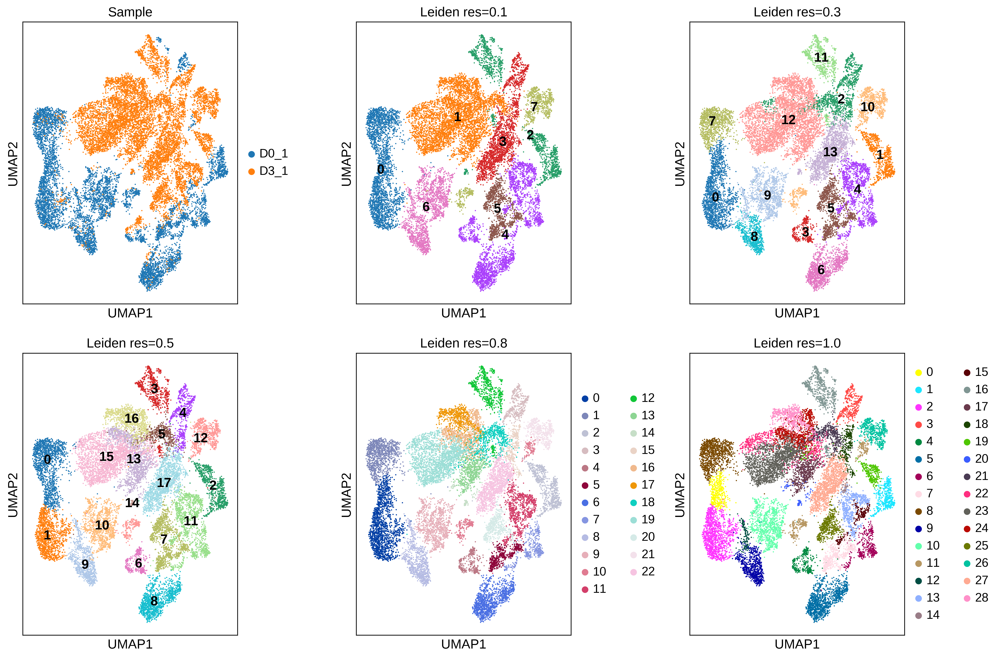


Default clustering set to leiden_res_1.0: 29 clusters

10. QC REASSESSMENT POST-CLUSTERING


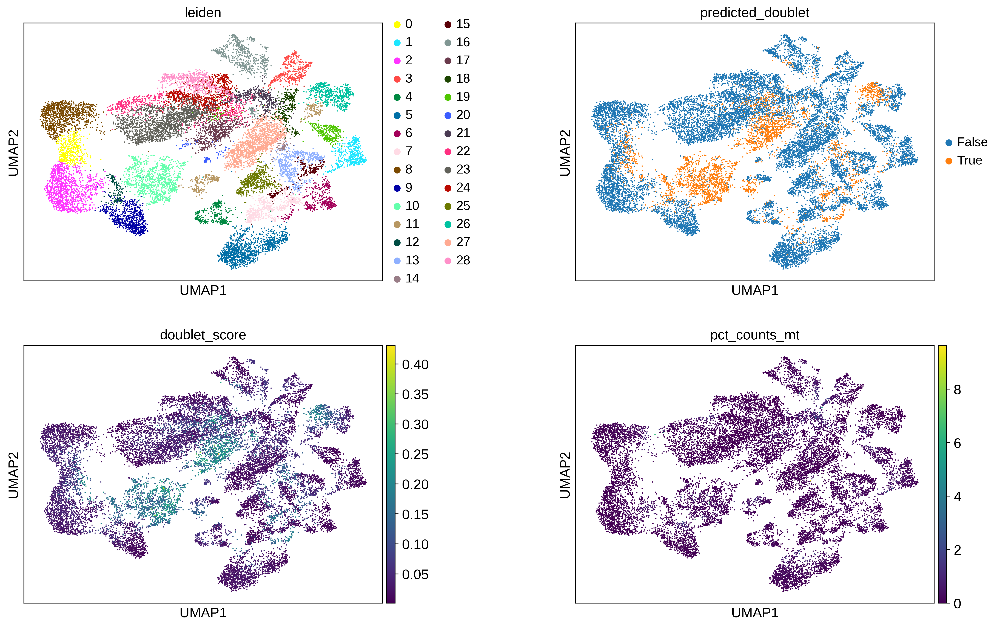

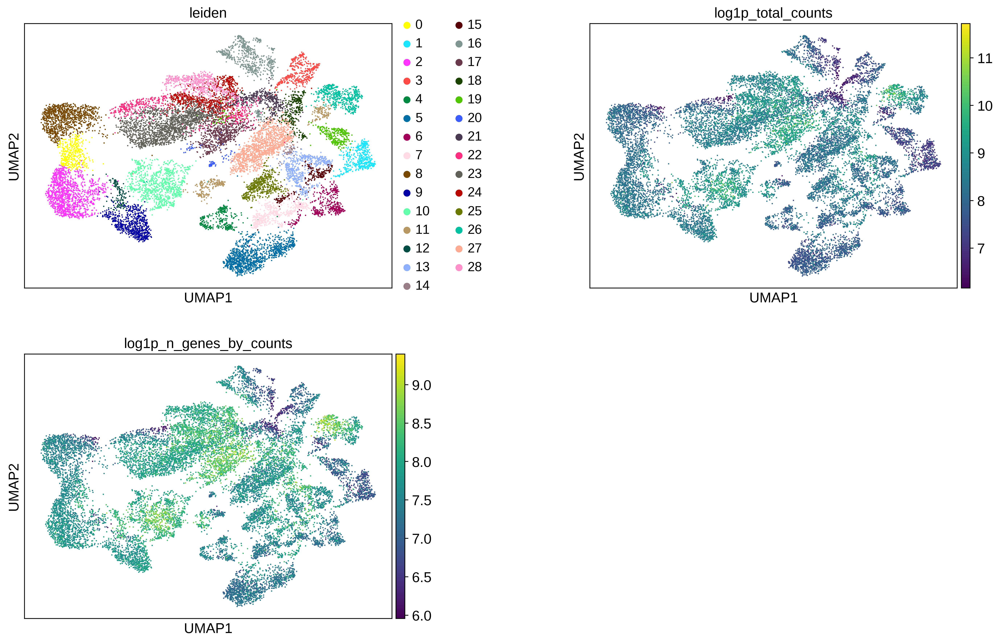


Cluster composition by sample (%):
sample  D0_1   D3_1
leiden             
0       99.8    0.2
1       99.3    0.7
2       96.8    3.2
3       29.9   70.1
4       59.3   40.7
5       96.5    3.5
6       99.0    1.0
7       84.9   15.1
8       95.1    4.9
9       97.0    3.0
10      98.2    1.8
11      69.9   30.1
12      98.5    1.5
13       5.5   94.5
14       0.0  100.0
15      55.9   44.1
16       6.5   93.5
17       0.5   99.5
18       0.3   99.7
19       0.3   99.7
20      23.4   76.6
21       1.1   98.9
22       0.2   99.8
23       0.3   99.7
24       0.4   99.6
25       0.8   99.2
26       0.2   99.8
27       0.0  100.0
28       0.0  100.0

11. MARKER GENE DETECTION - Top 1000 genes per cluster
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to b

In [2]:
#!/usr/bin/env python
"""
Standard Scanpy Analysis Pipeline for D0_1 and D3_1 samples
Following: https://scanpy.readthedocs.io/en/stable/tutorials/basics/clustering.html

No integration step - just standard preprocessing, QC, normalization, 
dimensionality reduction, and clustering.

Modified: Use Leiden 1.0, save top 1000 markers per cluster to pickle and xlsx
"""

import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pickle
import warnings
warnings.filterwarnings('ignore')
import os

# Set scanpy settings
sc.settings.set_figure_params(dpi=200, facecolor='white', figsize=(6, 5))
sc.settings.verbosity = 3

# =============================================================================
# CONFIGURATION - Update these paths
# =============================================================================
# Input: Combined h5ad file with D0_1 and D3_1 samples
INPUT_H5AD = "/home/data3/dianli/projects/kenji_rhabdo_2025/processed_data/soupx_count.h5ad"

# Output directory
OUTPUT_DIR = "/home/data3/dianli/projects/kenji_rhabdo_2025/processed_data/analysis/soupx_count/standard_analysis/no_integration/"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Sample column name
SAMPLE_COL = "sample"  # or "sample" depending on your data

# Samples to subset
SAMPLES_TO_USE = ["D0_1", "D3_1"]

# =============================================================================
# 1. LOAD DATA AND SUBSET TO D0_1 AND D3_1
# =============================================================================
print("=" * 60)
print("1. LOADING AND SUBSETTING DATA")
print("=" * 60)

# Load the combined adata
adata = sc.read_h5ad(INPUT_H5AD)
print(f"Loaded adata: {adata.shape[0]} cells x {adata.shape[1]} genes")

# Check sample column
print(f"\nSample distribution in '{SAMPLE_COL}':")
print(adata.obs[SAMPLE_COL].value_counts())

# # Subset to D0_1 and D3_1 only
# adata = adata[adata.obs[SAMPLE_COL].isin(SAMPLES_TO_USE)].copy()
# print(f"\nSubset to {SAMPLES_TO_USE}: {adata.shape[0]} cells x {adata.shape[1]} genes")
# print(adata.obs[SAMPLE_COL].value_counts())

# =============================================================================
# 2. QUALITY CONTROL
# =============================================================================
print("\n" + "=" * 60)
print("2. QUALITY CONTROL")
print("=" * 60)

# Mark gene types - for mouse, use "mt-" (lowercase) for mitochondrial
# Adjust prefixes based on your gene naming convention
adata.var["mt"] = adata.var_names.str.startswith(("mt-", "MT-", "Mt-"))  # mitochondrial
adata.var["ribo"] = adata.var_names.str.startswith(("Rps", "Rpl", "RPS", "RPL"))  # ribosomal
adata.var["hb"] = adata.var_names.str.contains("^Hb[^(p)]|^HB[^(P)]", regex=True)  # hemoglobin

# Calculate QC metrics
sc.pp.calculate_qc_metrics(
    adata, 
    qc_vars=["mt", "ribo", "hb"], 
    inplace=True, 
    log1p=True
)

print("\nQC metrics added to adata.obs:")
print([c for c in adata.obs.columns if 'counts' in c or 'genes' in c or 'pct' in c])

# Plot QC metrics
fig, axes = plt.subplots(1, 3, figsize=(14, 4))

# Violin plots
sc.pl.violin(
    adata,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
    ax=axes,
    show=False
)
plt.savefig(OUTPUT_DIR + "01_qc_violin.png", dpi=300, bbox_inches='tight')
plt.show()

# Scatter plot: counts vs genes, colored by mito %
sc.pl.scatter(
    adata, 
    x="total_counts", 
    y="n_genes_by_counts", 
    color="pct_counts_mt",
    show=False
)
plt.savefig(OUTPUT_DIR + "02_qc_scatter.png", dpi=300, bbox_inches='tight')
plt.show()

# QC by sample
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
for i, metric in enumerate(["n_genes_by_counts", "total_counts", "pct_counts_mt"]):
    sc.pl.violin(adata, metric, groupby=SAMPLE_COL, ax=axes[i], show=False)
plt.tight_layout()
plt.savefig(OUTPUT_DIR + "03_qc_by_sample.png", dpi=300, bbox_inches='tight')
plt.show()

print("QC plots saved.")

# =============================================================================
# 3. BASIC FILTERING
# =============================================================================
print("\n" + "=" * 60)
print("3. BASIC FILTERING")
print("=" * 60)

n_cells_before = adata.n_obs
n_genes_before = adata.n_vars

# Basic filtering - adjust thresholds as needed
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

print(f"Cells: {n_cells_before} -> {adata.n_obs} ({n_cells_before - adata.n_obs} removed)")
print(f"Genes: {n_genes_before} -> {adata.n_vars} ({n_genes_before - adata.n_vars} removed)")

# Optional: Filter by mitochondrial content and total counts
# Uncomment and adjust thresholds based on your QC plots
# adata = adata[adata.obs['pct_counts_mt'] < 20, :]
# adata = adata[adata.obs['n_genes_by_counts'] < 6000, :]
# adata = adata[adata.obs['n_genes_by_counts'] > 500, :]



# =============================================================================
# 4. DOUBLET DETECTION
# =============================================================================
print("\n" + "=" * 60)
print("4. DOUBLET DETECTION")
print("=" * 60)

# Run Scrublet for doublet detection per sample
sc.pp.scrublet(adata, batch_key=SAMPLE_COL)

print(f"\nDoublet detection results:")
print(f"Predicted doublets: {adata.obs['predicted_doublet'].sum()} / {adata.n_obs}")
print(f"Mean doublet score: {adata.obs['doublet_score'].mean():.4f}")

# Doublet scores by sample
print("\nDoublets per sample:")
print(adata.obs.groupby(SAMPLE_COL)['predicted_doublet'].sum())

# =============================================================================
# 5. NORMALIZATION
# =============================================================================
print("\n" + "=" * 60)
print("5. NORMALIZATION")
print("=" * 60)

# Save raw counts to a layer
adata.layers["counts"] = adata.X.copy()

# Normalize to median total counts (log1PF normalization)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

print("Normalization complete (normalize_total + log1p)")
print(f"Data stored in adata.X, raw counts in adata.layers['counts']")

# =============================================================================
# 6. FEATURE SELECTION (HVG)
# =============================================================================
print("\n" + "=" * 60)
print("6. FEATURE SELECTION (HIGHLY VARIABLE GENES)")
print("=" * 60)

# Identify highly variable genes
# Using batch_key to account for sample-specific variation
sc.pp.highly_variable_genes(
    adata, 
    n_top_genes=2000, 
    batch_key=SAMPLE_COL,
    flavor='seurat_v3',
    layer='counts'  # Use raw counts for HVG selection
)

print(f"\nHighly variable genes: {adata.var['highly_variable'].sum()}")

# Plot HVG
sc.pl.highly_variable_genes(adata, show=False)
plt.savefig(OUTPUT_DIR + "04_hvg.png", dpi=300, bbox_inches='tight')
plt.show()

# =============================================================================
# 7. DIMENSIONALITY REDUCTION (PCA)
# =============================================================================
print("\n" + "=" * 60)
print("7. DIMENSIONALITY REDUCTION (PCA)")
print("=" * 60)

# Scale data (optional but recommended before PCA)
# Note: Only affects PCA, doesn't modify adata.X permanently if you use mask_var
# sc.pp.scale(adata, max_value=10)

# Run PCA
sc.tl.pca(adata, svd_solver='arpack', n_comps=50)

print(f"PCA complete: {adata.obsm['X_pca'].shape}")

# Plot variance ratio
sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True, show=False)
plt.savefig(OUTPUT_DIR + "05_pca_variance.png", dpi=300, bbox_inches='tight')
plt.show()

# PCA colored by sample and QC metrics
sc.pl.pca(
    adata,
    color=[SAMPLE_COL, "pct_counts_mt", "n_genes_by_counts", "doublet_score"],
    ncols=2,
    show=False
)
plt.savefig(OUTPUT_DIR + "06_pca_qc.png", dpi=300, bbox_inches='tight')
plt.show()

# =============================================================================
# 8. NEIGHBOR GRAPH AND UMAP
# =============================================================================
print("\n" + "=" * 60)
print("8. NEIGHBOR GRAPH AND UMAP")
print("=" * 60)

# Compute neighborhood graph
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=30)

# Compute UMAP
sc.tl.umap(adata)

print("UMAP complete.")

# Plot UMAP by sample
sc.pl.umap(adata, color=SAMPLE_COL, size=10, show=False)
plt.savefig(OUTPUT_DIR + "07_umap_sample.png", dpi=300, bbox_inches='tight')
plt.show()

# =============================================================================
# 9. CLUSTERING (LEIDEN) - Using resolution 1.0
# =============================================================================
print("\n" + "=" * 60)
print("9. CLUSTERING (LEIDEN) - Resolution 1.0")
print("=" * 60)

# Run Leiden clustering at multiple resolutions for comparison
resolutions = [0.1, 0.3, 0.5, 0.8, 1.0]

for res in resolutions:
    sc.tl.leiden(
        adata, 
        key_added=f"leiden_res_{res:.1f}", 
        resolution=res,
        flavor="igraph",
        n_iterations=2
    )
    n_clusters = adata.obs[f"leiden_res_{res:.1f}"].nunique()
    print(f"Resolution {res}: {n_clusters} clusters")

# Plot all clustering resolutions
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

# Plot sample
sc.pl.umap(adata, color=SAMPLE_COL, ax=axes[0], show=False, title="Sample")

# Plot each resolution
for i, res in enumerate(resolutions):
    sc.pl.umap(
        adata, 
        color=f"leiden_res_{res:.1f}", 
        ax=axes[i+1], 
        show=False,
        title=f"Leiden res={res}",
        legend_loc='on data' if res <= 0.5 else 'right margin'
    )

plt.tight_layout()
plt.savefig(OUTPUT_DIR + "08_leiden_resolutions.png", dpi=300, bbox_inches='tight')
plt.show()

# *** SET DEFAULT CLUSTERING TO RESOLUTION 1.0 ***
adata.obs['leiden'] = adata.obs['leiden_res_1.0']
print(f"\nDefault clustering set to leiden_res_1.0: {adata.obs['leiden'].nunique()} clusters")

# =============================================================================
# 10. QC REASSESSMENT POST-CLUSTERING
# =============================================================================
print("\n" + "=" * 60)
print("10. QC REASSESSMENT POST-CLUSTERING")
print("=" * 60)

# UMAP with QC metrics and clustering
sc.pl.umap(
    adata,
    color=["leiden", "predicted_doublet", "doublet_score", "pct_counts_mt"],
    ncols=2,
    wspace=0.4,
    show=False
)
plt.savefig(OUTPUT_DIR + "09_umap_qc_assessment.png", dpi=300, bbox_inches='tight')
plt.show()

sc.pl.umap(
    adata,
    color=["leiden", "log1p_total_counts", "log1p_n_genes_by_counts"],
    ncols=2,
    wspace=0.4,
    show=False
)
plt.savefig(OUTPUT_DIR + "10_umap_counts.png", dpi=300, bbox_inches='tight')
plt.show()

# Check cluster composition by sample
cluster_sample = pd.crosstab(
    adata.obs['leiden'], 
    adata.obs[SAMPLE_COL], 
    normalize='index'
) * 100
print("\nCluster composition by sample (%):")
print(cluster_sample.round(1))



# =============================================================================
# 11. MARKER GENE DETECTION - Top 1000 genes per cluster
# =============================================================================
print("\n" + "=" * 60)
print("11. MARKER GENE DETECTION - Top 1000 genes per cluster")
print("=" * 60)

# Find marker genes for each cluster
sc.tl.rank_genes_groups(adata, groupby='leiden', method='wilcoxon')

# Plot top markers (dotplot with top 5 for visualization)
sc.pl.rank_genes_groups_dotplot(
    adata, 
    groupby='leiden', 
    n_genes=5,
    standard_scale='var',
    show=False
)
plt.savefig(OUTPUT_DIR + "11_marker_dotplot.png", dpi=300, bbox_inches='tight')
plt.show()



In [3]:
# =============================================================================
# 11b. SAVE TOP 1000 MARKERS PER CLUSTER TO PICKLE AND XLSX
# =============================================================================
print("\n" + "-" * 40)
print("Saving top 1000 markers per cluster...")
print("-" * 40)

# Get all clusters
clusters = adata.obs['leiden'].cat.categories.tolist()

# Dictionary to store top 1000 markers for each cluster
markers_dict = {}

for cluster in clusters:
    # Get marker genes for this cluster (top 1000)
    markers_df = sc.get.rank_genes_groups_df(adata, group=cluster)
    markers_df_top1000 = markers_df.head(1000)
    markers_dict[f"cluster_{cluster}"] = markers_df_top1000
    print(f"  Cluster {cluster}: {len(markers_df_top1000)} genes")

# Save as pickle file
pickle_path = OUTPUT_DIR + "marker_genes_top1000_per_cluster.pkl"
with open(pickle_path, 'wb') as f:
    pickle.dump(markers_dict, f)
print(f"\nPickle file saved: {pickle_path}")

# Save as Excel file with each cluster as a separate tab
xlsx_path = OUTPUT_DIR + "marker_genes_top1000_per_cluster.xlsx"
with pd.ExcelWriter(xlsx_path, engine='openpyxl') as writer:
    for cluster in clusters:
        sheet_name = f"cluster_{cluster}"
        # Excel sheet names have max 31 characters
        if len(sheet_name) > 31:
            sheet_name = sheet_name[:31]
        markers_dict[f"cluster_{cluster}"].to_excel(writer, sheet_name=sheet_name, index=False)
print(f"Excel file saved: {xlsx_path}")

# Also save all markers to a single CSV (as before)
markers_df_all = sc.get.rank_genes_groups_df(adata, group=None)
markers_df_all.to_csv(OUTPUT_DIR + "marker_genes_all_clusters.csv", index=False)
print(f"All markers CSV saved: {OUTPUT_DIR}marker_genes_all_clusters.csv")

# Print top 5 markers per cluster
print("\nTop 5 markers per cluster:")
for cluster in clusters:
    top5 = markers_dict[f"cluster_{cluster}"].head(5)['names'].tolist()
    print(f"  Cluster {cluster}: {', '.join(top5)}")

# =============================================================================
# 12. SAVE RESULTS
# =============================================================================
print("\n" + "=" * 60)
print("12. SAVING RESULTS")
print("=" * 60)

# Save the processed adata
output_path = OUTPUT_DIR + "adata_processed.h5ad"
adata.write(output_path)
print(f"\nProcessed adata saved to: {output_path}")

# Summary
print("\n" + "=" * 60)
print("ANALYSIS COMPLETE")
print("=" * 60)
print(f"Final shape: {adata.n_obs} cells x {adata.n_vars} genes")
print(f"Samples: {adata.obs[SAMPLE_COL].unique().tolist()}")
print(f"Clusters (leiden res=1.0): {adata.obs['leiden'].nunique()}")
print(f"\nOutput files saved to: {OUTPUT_DIR}")
print("""
Files generated:
  - 01_qc_violin.png
  - 02_qc_scatter.png
  - 03_qc_by_sample.png
  - 04_hvg.png
  - 05_pca_variance.png
  - 06_pca_qc.png
  - 07_umap_sample.png
  - 08_leiden_resolutions.png
  - 09_umap_qc_assessment.png
  - 10_umap_counts.png
  - 11_marker_dotplot.png
  - marker_genes_all_clusters.csv
  - marker_genes_top1000_per_cluster.pkl
  - marker_genes_top1000_per_cluster.xlsx
  - adata_processed.h5ad
""")


----------------------------------------
Saving top 1000 markers per cluster...
----------------------------------------
  Cluster 0: 1000 genes
  Cluster 1: 1000 genes
  Cluster 2: 1000 genes
  Cluster 3: 1000 genes
  Cluster 4: 1000 genes
  Cluster 5: 1000 genes
  Cluster 6: 1000 genes
  Cluster 7: 1000 genes
  Cluster 8: 1000 genes
  Cluster 9: 1000 genes
  Cluster 10: 1000 genes
  Cluster 11: 1000 genes
  Cluster 12: 1000 genes
  Cluster 13: 1000 genes
  Cluster 14: 1000 genes
  Cluster 15: 1000 genes
  Cluster 16: 1000 genes
  Cluster 17: 1000 genes
  Cluster 18: 1000 genes
  Cluster 19: 1000 genes
  Cluster 20: 1000 genes
  Cluster 21: 1000 genes
  Cluster 22: 1000 genes
  Cluster 23: 1000 genes
  Cluster 24: 1000 genes
  Cluster 25: 1000 genes
  Cluster 26: 1000 genes
  Cluster 27: 1000 genes
  Cluster 28: 1000 genes

Pickle file saved: /home/data3/dianli/projects/kenji_rhabdo_2025/processed_data/analysis/soupx_count/standard_analysis/no_integration/marker_genes_top1000_per_clu

In [4]:
# cluster_to_celltype = {
#     # ========== FILL IN YOUR ANNOTATIONS BELOW ==========
#     "0": "Unknown_0",
#     "1": "Unknown_1",
#     "2": "Unknown_2",
#     "3": "Unknown_3",
#     "4": "Unknown_4",
#     "5": "Unknown_5",
#     "6": "Unknown_6",
#     "7": "Unknown_7",
#     "8": "Unknown_8",
#     "9": "Unknown_9",
#     "10": "Unknown_10",
#     "11": "Unknown_11",
#     "12": "Unknown_12",
#     "13": "Unknown_13",
#     "14": "Unknown_14",
#     "15": "Unknown_15",
#     "16": "Unknown_16",
#     "17": "Unknown_17",
#     "18": "Unknown_18",
#     "19": "Unknown_19",
#     "20": "Unknown_20",
#     # Add more clusters as needed...
#     # ========== END OF ANNOTATIONS ==========
# }

# # =============================================================================
# # APPLY CELL TYPE ANNOTATIONS
# # =============================================================================
# print("\nApplying cell type annotations...")

# # Get existing clusters
# existing_clusters = adata.obs[CLUSTER_COL].unique().tolist()

# # Check for missing annotations
# missing = [c for c in existing_clusters if str(c) not in cluster_to_celltype]
# if missing:
#     print(f"WARNING: Missing annotations for clusters: {missing}")
#     print("These will be labeled as 'Unannotated'")
#     for c in missing:
#         cluster_to_celltype[str(c)] = f"Unannotated_{c}"

# adata.obs['celltype_bk1'] = adata.obs['celltype'].copy()

# # Create new annotation column
# adata.obs['celltype'] = adata.obs[CLUSTER_COL].astype(str).map(cluster_to_celltype)

# # Convert to categorical for proper ordering
# adata.obs['celltype'] = pd.Categorical(adata.obs['celltype'])

# # Print annotation summary
# print("\nCell type distribution:")
# print(adata.obs['celltype'].value_counts())

# # =============================================================================
# # GENERATE ANNOTATED UMAP PLOTS
# # =============================================================================
# print("\nGenerating annotated UMAP plots...")

# # 1. UMAP with cell type annotations
# fig, ax = plt.subplots(figsize=(10, 8))
# sc.pl.umap(
#     adata, 
#     color='celltype', 
#     ax=ax,
#     title='Cell Type Annotations',
#     legend_loc='right margin',
#     legend_fontsize=8,
#     show=False
# )
# plt.tight_layout()
# plt.savefig(OUTPUT_DIR + "umap_celltype.png", dpi=300, bbox_inches='tight')
# plt.close()
# print(f"Saved: {OUTPUT_DIR}umap_celltype.png")

# # 2. UMAP with cell type annotations - labels on data
# fig, ax = plt.subplots(figsize=(10, 8))
# sc.pl.umap(
#     adata, 
#     color='celltype', 
#     ax=ax,
#     title='Cell Type Annotations (labels on data)',
#     legend_loc='on data',
#     legend_fontsize=6,
#     show=False
# )
# plt.tight_layout()
# plt.savefig(OUTPUT_DIR + "umap_celltype_labels_on_data.png", dpi=300, bbox_inches='tight')
# plt.close()
# print(f"Saved: {OUTPUT_DIR}umap_celltype_labels_on_data.png")

# # 3. Side-by-side comparison: clusters vs cell types
# fig, axes = plt.subplots(1, 2, figsize=(16, 6))
# sc.pl.umap(adata, color=CLUSTER_COL, ax=axes[0], title='Leiden Clusters', 
#            legend_loc='on data', legend_fontsize=8, show=False)
# sc.pl.umap(adata, color='celltype', ax=axes[1], title='Cell Type Annotations',
#            legend_loc='right margin', legend_fontsize=8, show=False)
# plt.tight_layout()
# plt.savefig(OUTPUT_DIR + "umap_cluster_vs_celltype.png", dpi=300, bbox_inches='tight')
# plt.close()
# print(f"Saved: {OUTPUT_DIR}umap_cluster_vs_celltype.png")

# # 4. UMAP split by sample
# if 'sample' in adata.obs.columns:
#     samples = adata.obs['sample'].unique()
#     n_samples = len(samples)
#     fig, axes = plt.subplots(1, n_samples, figsize=(6*n_samples, 5))
#     if n_samples == 1:
#         axes = [axes]
#     for i, sample in enumerate(samples):
#         sc.pl.umap(
#             adata[adata.obs['sample'] == sample],
#             color='celltype',
#             ax=axes[i],
#             title=f'{sample}',
#             legend_loc='right margin' if i == n_samples-1 else 'none',
#             legend_fontsize=8,
#             show=False
#         )
#     plt.tight_layout()
#     plt.savefig(OUTPUT_DIR + "umap_celltype_by_sample.png", dpi=300, bbox_inches='tight')
#     plt.close()
#     print(f"Saved: {OUTPUT_DIR}umap_celltype_by_sample.png")



In [ ]:
# # =============================================================================
# # SAVE ANNOTATED DATA
# # =============================================================================
# output_h5ad = OUTPUT_DIR + "adata_annotated.h5ad"
# adata.write(output_h5ad)
# print(f"\nAnnotated data saved to: {output_h5ad}")

# # Save annotation mapping for reference
# annotation_df = pd.DataFrame({
#     'cluster': list(cluster_to_celltype.keys()),
#     'cell_type': list(cluster_to_celltype.values())
# })
# annotation_df.to_csv(OUTPUT_DIR + "cluster_to_celltype_mapping.csv", index=False)
# print(f"Annotation mapping saved to: {OUTPUT_DIR}cluster_to_celltype_mapping.csv")

# # =============================================================================
# # SUMMARY
# # =============================================================================
# print("\n" + "=" * 60)
# print("ANNOTATION COMPLETE")
# print("=" * 60)
# print(f"Total cells: {adata.n_obs}")
# print(f"Cell types: {adata.obs['cell_type'].nunique()}")
# print(f"\nOutput files:")
# print(f"  - umap_celltype.png")
# print(f"  - umap_celltype_labels_on_data.png")
# print(f"  - umap_cluster_vs_celltype.png")
# print(f"  - umap_celltype_by_sample.png")
# print(f"  - adata_annotated.h5ad")
# print(f"  - cluster_to_celltype_mapping.csv")